In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import re
from collections import Counter
import plotly.graph_objects as go

In [5]:
df = pd.read_csv('base5.csv', low_memory=False)

In [6]:
pd.set_option('display.max_columns', None)
display(df)

,Age,Ethnicity,Gender,Confirmed date,Method of confirmation,Hospital admission date,Hospital admission,Icu admission date,Icu Admission,Date of onset of symptoms,Outcome date,Outcome values,State,District,Pre-existing conditions,List of pre-existing conditions,Symptom status,Symptpms,Age Range,Internment days,Condition1,Condition2,Condition3,Condition4,Condition5,Condition6,Condition7,Condition8,Condition9,Condition10,Condition11,Condition12,Condition13
0,68,Unknown,Female,2020-03-30,PCR test,2020-03-30,Yes,NaN,No,2020-03-29,2020-04-06,Recovered,São Paulo,São Paulo,True,"heart disease,asthma,other comorbidity listed ...",Symptomatic,"dyspnea,fever,cough,hypoxemia,diarrhoea,vomiting",65-69,7.0,heart disease,asthma,has,hipotireoidismo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,68,White,Male,2020-04-01,PCR test,2020-04-01,Yes,NaN,No,2020-03-26,2020-04-15,Death,São Paulo,São Paulo,True,asthma,Symptomatic,"dyspnea,fever,cough",65-69,14.0,asthma,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,48,White,Male,2020-04-02,PCR test,2020-04-02,Yes,NaN,No,2020-04-01,2020-04-03,Recovered,São Paulo,São Paulo,True,heart disease,Symptomatic,"throat pain,dyspnea,fever,cough",45-49,1.0,heart disease,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,63,White,Male,2020-04-04,PCR test,2020-04-04,Yes,NaN,No,2020-03-23,2020-04-10,Recovered,São Paulo,São Paulo,True,heart disease,Symptomatic,"dyspnea,fever,cough,hypoxemia",60-64,6.0,heart disease,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,83,Mixed,Female,2020-04-04,PCR test,2020-04-04,Yes,2020-04-21,Yes,2020-04-04,2020-04-21,Death,São Paulo,Franco da Rocha,True,heart disease,Symptomatic,"dyspnea,fever,cough,hypoxemia",80-84,17.0,heart disease,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
878584,63,Mixed,Female,2021-12-19,PCR test,2021-12-18,Yes,NaN,No,2021-12-17,2021-12-31,Recovered,Paraíba,Santa Rita,True,other comorbidity listed as: HAS,Symptomatic,dyspnea,60-64,13.0,has,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
878585,63,White,Male,2021-11-28,Unknow,2021-11-28,Yes,NaN,No,2021-11-27,2021-12-07,Recovered,Rio Grande do Sul,Canoas,True,heart disease,Symptomatic,"dyspnea,cough,abdominal discomfort",60-64,9.0,heart disease,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
878586,33,White,Male,2021-12-17,PCR test,2021-12-17,Yes,2022-01-06,Yes,2021-12-07,2022-01-06,Death,Rio Grande do Sul,Novo Hamburgo,True,obesity,Symptomatic,"throat pain,dyspnea,fever,cough,hypoxemia,fatigue",30-34,20.0,obesity,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
878587,53,White,Male,2021-05-29,PCR test,2021-05-29,Yes,NaN,No,2021-05-24,2021-06-06,Death,São Paulo,Ariranha,True,diabetes mellitus,Symptomatic,"dyspnea,hypoxemia",50-54,8.0,diabetes mellitus,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
# Converter as colunas para datetime, caso ainda não estejam
df['Date of onset of symptoms'] = pd.to_datetime(df['Date of onset of symptoms'])
df['Hospital admission date'] = pd.to_datetime(df['Hospital admission date'])
df['Outcome date'] = pd.to_datetime(df['Outcome date'])

# Calcular o intervalo entre a data de início dos sintomas e a data de admissão no hospital
df['Symptom_Hospitalization_Interval'] = (df['Hospital admission date'] - df['Date of onset of symptoms']).dt.days

# Calcular o intervalo entre a data de admissão no hospital e a data do desfecho
df['Hospitalization_Interval'] = (df['Outcome date'] - df['Hospital admission date']).dt.days

In [5]:
df['Symptom_Hospitalization_Interval'].describe()
df['Hospitalization_Interval'].describe()

count    878589.000000
mean         12.577105
std          15.044456
min           0.000000
25%           5.000000
50%           8.000000
75%          15.000000
max         407.000000
Name: Hospitalization_Interval, dtype: float64

In [6]:
fig = go.Figure()

# Adicionar o gráfico de dispersão
fig.add_trace(go.Scatter(
    x=df['Symptom_Hospitalization_Interval'],
    y=df['Hospitalization_Interval'],
    mode='markers',
    marker=dict(color='blue', opacity=0.5)
    #hoverinfo='text'
))

# Atualizar layout
fig.update_layout(
    title='Correlação entre os intervalos',
    xaxis_title='Intervalo entre início dos sintomas e internação',
    yaxis_title='Tempo de internação',
    #hovermode='closest',  # Modo de interação ao passar o mouse
    xaxis=dict(tickmode='linear'),  # Modo de tick linear no eixo x
    yaxis=dict(tickmode='linear'),  # Modo de tick linear no eixo y
    showlegend=False,  # Não exibir legenda neste exemplo
    margin=dict(l=0, r=0, t=30, b=0),  # Margens do gráfico
)

# Exibir o gráfico
fig.show()

In [106]:
"""#03/10/2024
#df = df.drop(columns=['Full name of location','Travelled in the past 30 days','Occupation','Country reported','Latitude','Longitude','location.geoResolution','Location place','First created date','First vaccine batch','Date of first vaccine','vaccines.1.batch','Date of the second vaccine','City'])

df['Hospital admission date'] = pd.to_datetime(df['Hospital admission date'])
df['Confirmed date'] = pd.to_datetime(df['Confirmed date'])

indices_para_excluir = df[(df['Hospital admission date'].dt.year >= 2022) | (df['Confirmed date'].dt.year >= 2022)].index

df = df.drop(indices_para_excluir)

df = df.dropna(subset=['Hospital admission date', 'Confirmed date', 'Pre-existing conditions','Icu Admission','Outcome date','Symptom status','Symptpms'])
df = df.rename(columns={'Hospital admission date.1': 'Date of onset of symptoms',
                        'Media Idade': 'Age',
                        'Faixa etaria': 'Age Range',
                        'events.icuAdmission.value': 'Icu Admission'})



colunas_com_valores_vazios = df.columns[df.isnull().any()]

# Imprimir as colunas com valores vazios
print("Colunas com valores vazios:")
print(colunas_com_valores_vazios)

valores_vazios = df['Symptom status'].isnull().sum()
print(valores_vazios)

"""

Colunas com valores vazios:
Index(['Ethnicity', 'Method of confirmation', 'Icu admission date'], dtype='object')
0


In [28]:
#10/06/2024
"""
valores_vazios = df['Method of confirmation'].isnull().sum()
print(valores_vazios)

valor_definido = 'Unknow'  # ou qualquer outro valor que você desejar
coluna = 'Ethnicity'

df[coluna] = df[coluna].fillna(valor_definido)

valor_definido = 'Unknow'  # ou qualquer outro valor que você desejar
coluna = 'Method of confirmation'

df[coluna] = df[coluna].fillna(valor_definido)"""
"""
print(df[' Revision number of the case '].unique())
df = df.drop(columns=[' Revision number of the case '])"""

[0]


In [42]:
# Substituir "Unknow" por "Unknown" na coluna "Ethnicity"
df['Ethnicity'] = df['Ethnicity'].replace('Unknow', 'Unknown')

In [ ]:
#RODAR ESTE CODIGO
# #separar por virgula
max_conditions = df['List of pre-existing conditions'].str.split(',').apply(len).max()

# Criar novas colunas dinamicamente
new_cols = [f'Condition{i+1}' for i in range(max_conditions)]
df[new_cols] = df['List of pre-existing conditions'].str.split(',', expand=True)

# Exibir o DataFrame resultante
df

In [ ]:
#CORRIGI TEXTOS DAS COLUNAS CONDIÇOES PRE EXISTENTES

# Função para remover "other comorbidity listed as: "
def extract_condition(condition_str):
    if isinstance(condition_str, str):
        match = re.search(r'other comorbidity listed as: (.+)', condition_str)
        if match:
            return match.group(1)
    return condition_str

# Função para substituir padrões
def replace_patterns(text):
    if isinstance(text, str):
        # Substitui "ex tabagista" ou "ex fumante" ou "ex-fumante" por "ex-tabagista"
        text = re.sub(r'\bex tabagista\b|\bex. tabagista\b|\bex- tabagista\b|\bex - tabagista\b|\bex -tabagista\b|\bex - fumante\b|\bex-fumante\b|\bex- fumante\b|\bex -fumante\b', 'ex-tabagista', text)
        # corrigi ex etilista
        text = re.sub(r'\bex etilista\b|\bex. etilista\b|\bex- etilista\b|\bex - etilista\b|\bex -etilista\b|\bex - etilista\b|\bex-etilista\b|\bex- etilista\b|\bex -etilista\b', 'ex-etilista', text)
        # Substitui "hipotiroidismo" por "hipotireoidismo"
        text = re.sub(r'hipotiroidismo', 'hipotireoidismo', text)
        # Substitui "obesidade" ou "obesidade sem imc" por "obesity"
        text = re.sub(r'\bobesidade\b|\bobesidade sem imc\b', 'obesity', text)
        # Corrige outras condições
        text = re.sub(r'\bhipertensão\b|\bhipertensao\b|\bhipertenso\b|\bhipertensa\b|\bipertensa\b|\bhipertensao arterial\b|\bhipertensão arterial\b', 'hypertension', text)
        text = re.sub(r'\bhipertensão arterial sistemica\b|\bHAS\b|\bH.A.S\b|\bh.a.s\b|\bhipertensao arterial sistemica\b', 'has', text)
        text = re.sub(r'\bca prostata\b|\bca de prostata\b|\bcâncer de prostata\b|\bcâncer prostata\b|\bca próstata\b|\bca de próstata\b|\bcâncer de próstata\b|\bcâncer próstata\b', 'cancer de prostata', text)
    return text

df

In [37]:
columns_to_process = ['Condition1', 'Condition2', 'Condition3','Condition4', 'Condition5', 'Condition6','Condition7', 'Condition8', 'Condition9','Condition10', 'Condition11', 'Condition12', 'Condition13']

# Aplicar a função extract_condition e converter para minúsculas para cada coluna
for col in columns_to_process:
    # Remove espaços em branco no início e no final das strings
    df[col] = df[col].str.strip()
    # Aplica a função extract_condition
    df[col] = df[col].apply(extract_condition)
    # Converte para minúsculas
    df[col] = df[col].str.lower()
    #Arruma os replace
    df[col] = df[col].apply(replace_patterns)
     # Remove espaços em branco no início e no final das strings
    df[col] = df[col].str.strip()

In [45]:
all_conditions = pd.concat([df[col] for col in columns_to_process])

# Remover valores None e vazios
all_conditions = all_conditions.dropna()
all_conditions = all_conditions[all_conditions != '']

# Contar a frequência de cada condição
condition_counts = Counter(all_conditions)

# Selecionar as 200 condições mais frequentes
most_common_conditions = condition_counts.most_common(200)

# Transformar o resultado em um DataFrame
df_condicoes_mais_frequentes = pd.DataFrame(most_common_conditions, columns=['Condition', 'Count'])
df_condicoes_mais_frequentes

,Condition,Count
0,heart disease,462856
1,diabetes mellitus,328463
2,has,151348
3,obesity,139341
4,chronic kidney disease,47263
...,...,...
195,arritmia cardiaca,120
196,neoplasia prostata,119
197,hbp,118
198,ca bexiga,118


In [44]:
df.to_csv('base5.csv', index=False)

In [46]:
df_condicoes_mais_frequentes.to_csv('condicoes_mais_frequentes.csv', index=False)

In [ ]:
"""# Separa os valores da coluna original em listas
df['valores_separados'] = df['List of pre-existing conditions'].str.split(',')

# Cria uma lista de todas as categorias únicas encontradas em todas as linhas
categorias = list(set([val for sublist in df['valores_separados'].dropna() for val in sublist]))

# Cria novas colunas para cada categoria
for categoria in categorias:
    df[categoria] = df['valores_separados'].apply(lambda x: categoria in x if isinstance(x, list) else False)

# Preenche com False nas células em que a categoria não está presente
df = df.fillna(False)

# Remove a coluna 'valores_separados', se necessário
df = df.drop(columns=['valores_separados'])

print(df)"""

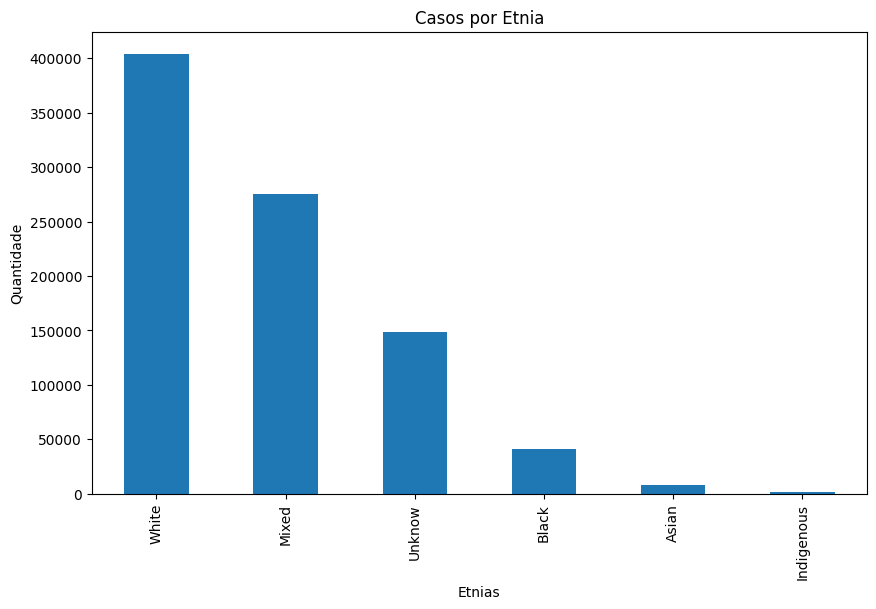

In [33]:
#CASOS POR ETNIA
contagem_etnias = df['Ethnicity'].value_counts()
# Plotagem do gráfico
plt.figure(figsize=(10, 6))
contagem_etnias.plot(kind='bar')
plt.title('Casos por Etnia')
plt.xlabel('Etnias')
plt.ylabel('Quantidade')
plt.show()

In [ ]:
#CASOS POR ETNIA
contagem_etnias = df['Method of confirmation'].value_counts()

plt.figure(figsize=(10, 6))
contagem_etnias.plot(kind='bar')
plt.title('Métodos de confirmação')
plt.xlabel('Método')
plt.ylabel('Quantidade')
plt.show()

In [ ]:
#RECUPERAÇÃO
contagem_outcome = df['Outcome values'].value_counts()

plt.figure(figsize=(8, 8))
contagem_outcome.plot(kind='pie', autopct='%1.1f%%', startangle=90)
plt.title('Status de Recuperação')
plt.ylabel('')
plt.show()

In [ ]:
#INTERNAÇÃO EM UTI
contagem_outcome = df['Icu Admission'].value_counts()

plt.figure(figsize=(8, 8))
contagem_outcome.plot(kind='pie', autopct='%1.1f%%', startangle=90)
plt.title('Internação em UTI')
plt.ylabel('')
plt.show()

In [30]:
df.to_csv('base4_PROVISORIA.csv', index=False)